In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob

In [2]:
images = glob.glob('camera_cal\calibration*.jpg')

In [3]:
# Arrays to store object points and image points from all the images
objpoints = [] # 3D points in real world space
imgpoints = [] # 2D points in image plane

In [4]:
# Prepare object points
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1, 2)

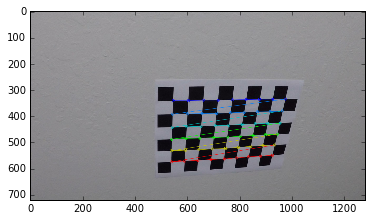

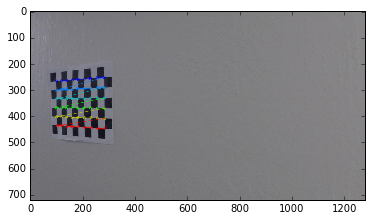

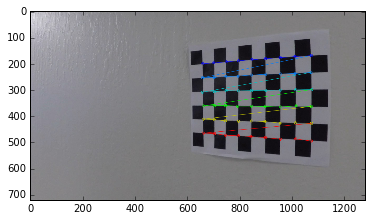

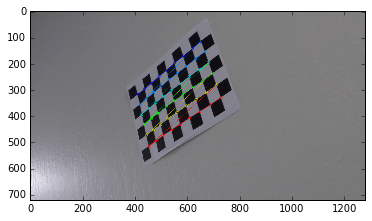

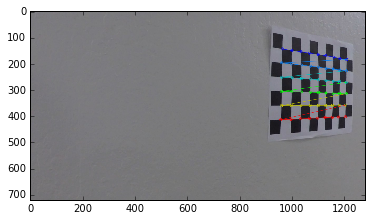

...

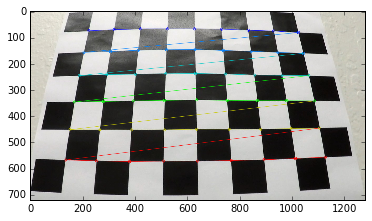

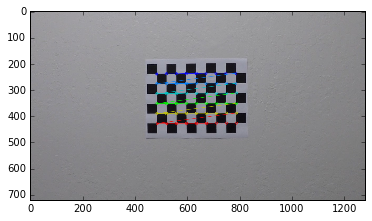

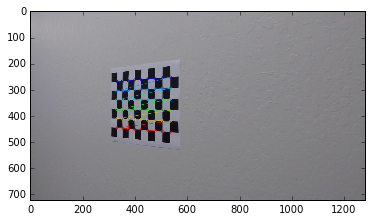

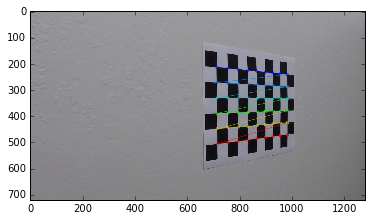

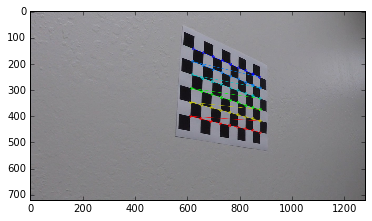

In [5]:
%matplotlib inline

for fname in images:
    img = mpimg.imread(fname)
    
    # Convert image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)
    
    # If corners are found, add object points, image points
    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)
        
        # draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        plt.imshow(img)
        plt.show()
        

In [6]:
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

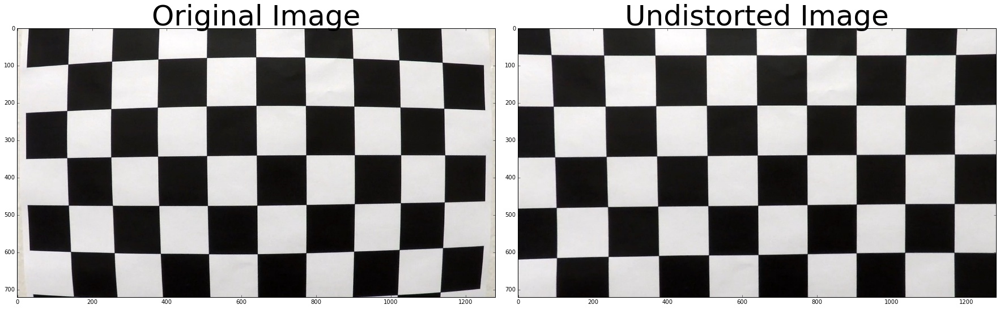

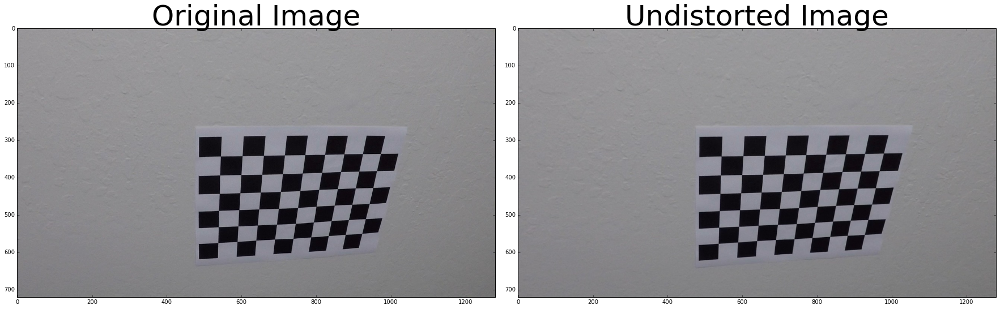

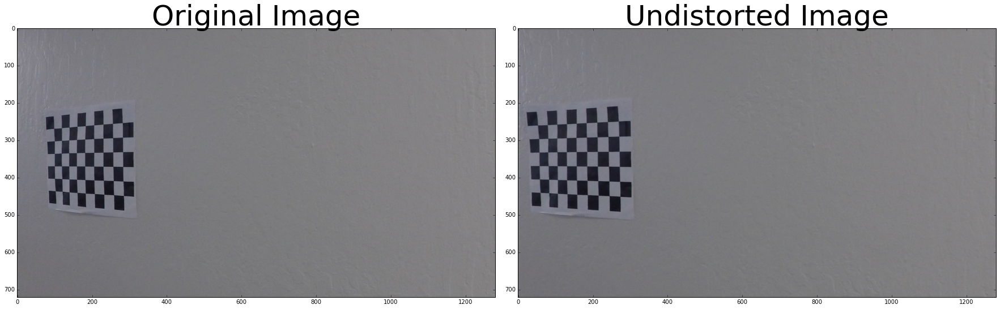

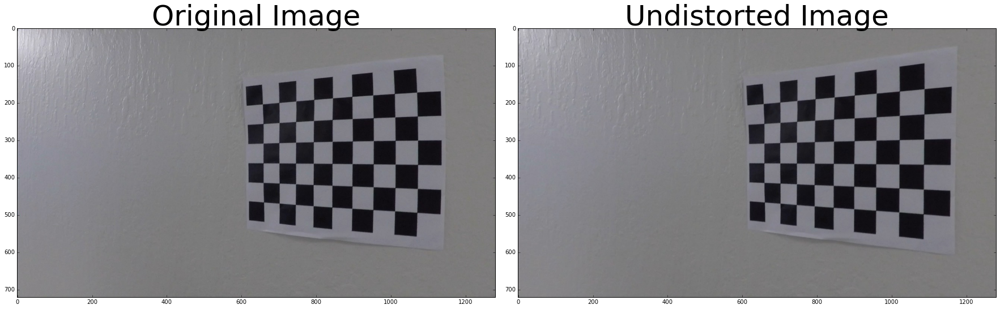

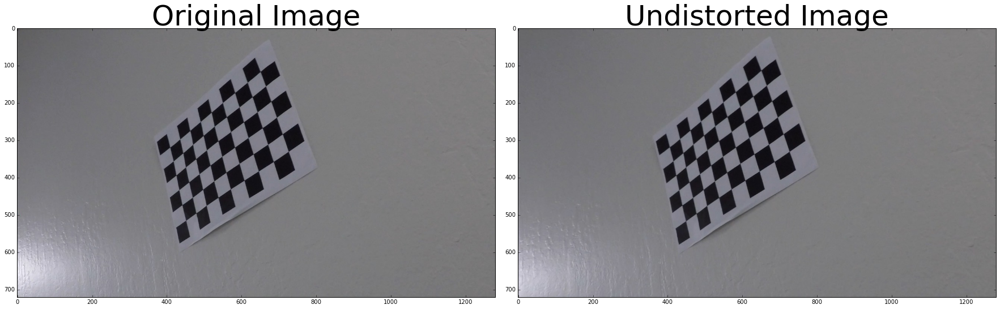

...

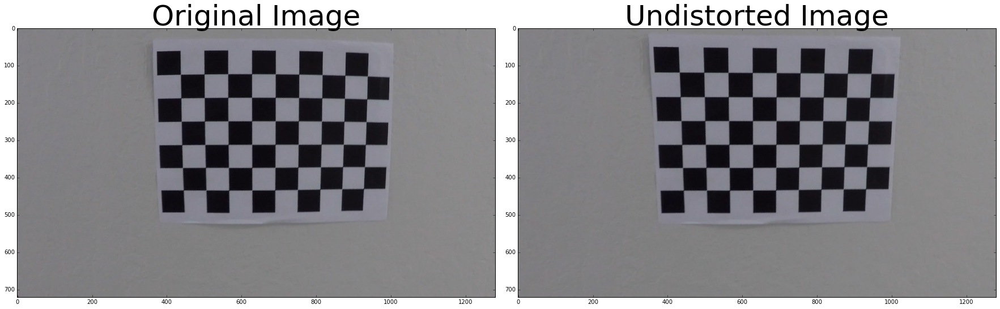

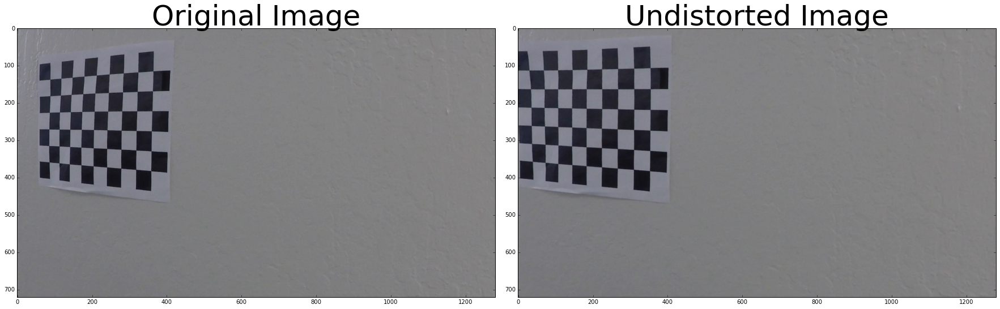

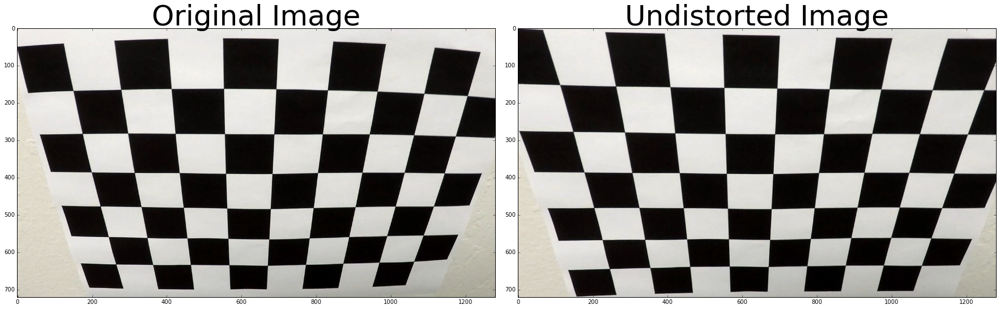

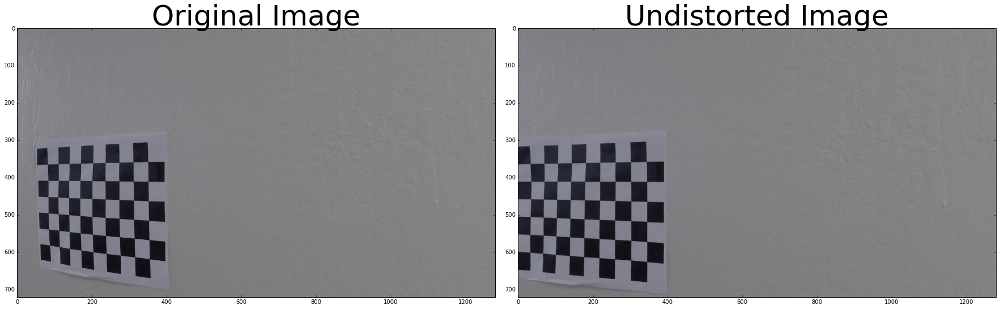

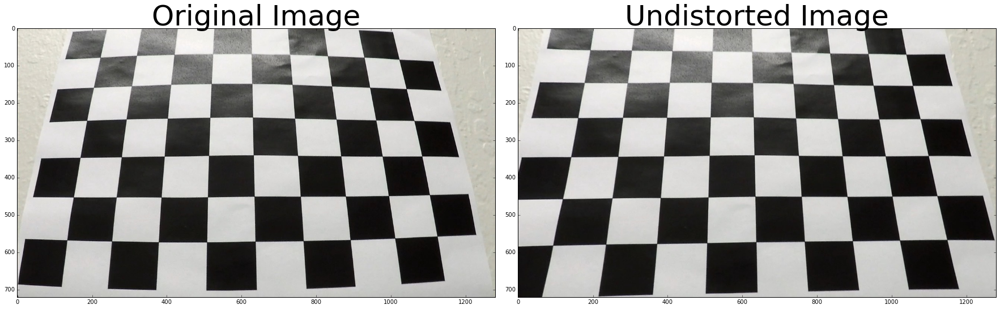

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


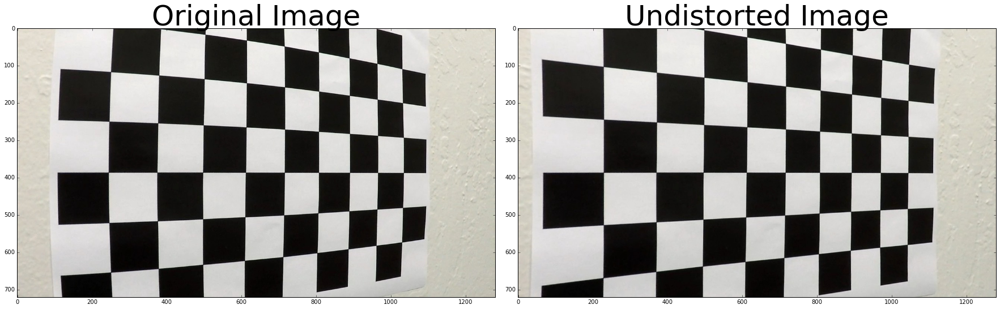

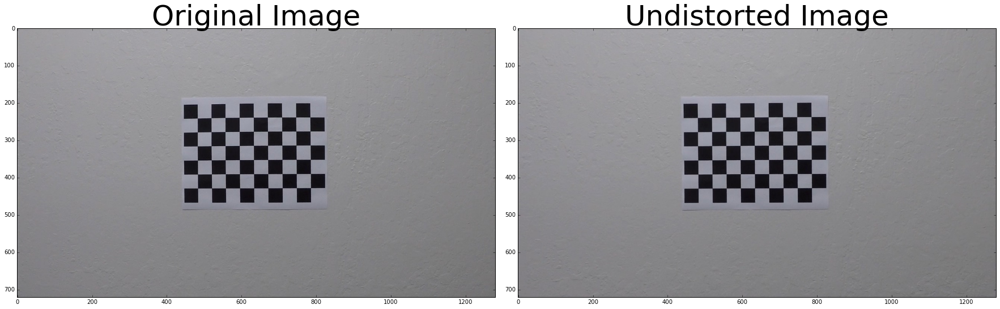

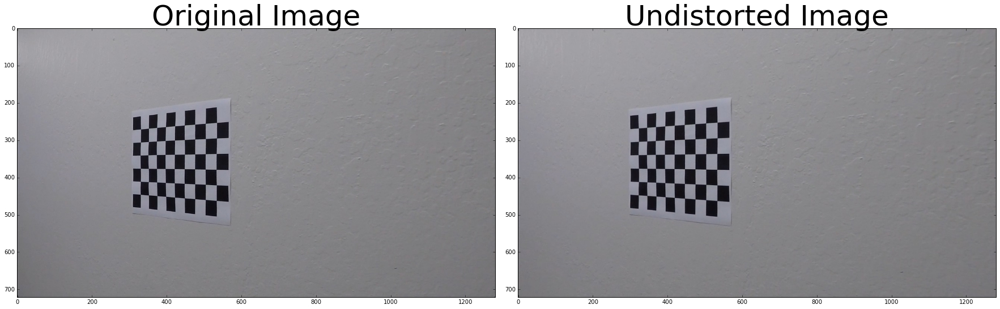

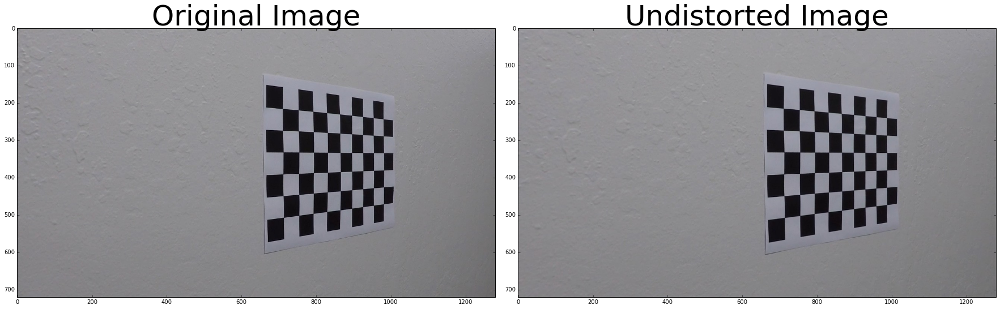

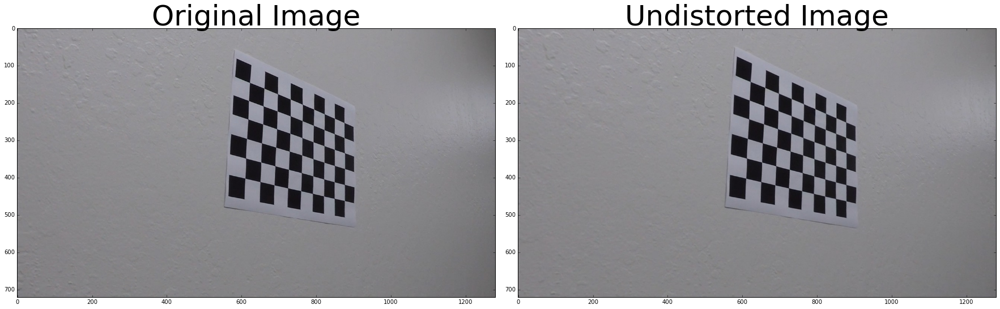

In [7]:
for fname in images:
    img = mpimg.imread(fname)
    
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24,9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undist)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0, right=1, top=0.9, bottom=0)
    # plt.show()

In [8]:
def abs_sobel_thresh(img_ch, orient='x', thresh_min=0, thresh_max=255):
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(img_ch, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(img_ch, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    # Return the result
    return binary_output

def mag_thresh(img_ch, sobel_kernel=3, thresh=(0, 255)):
    # Convert to grayscale
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(img_ch, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img_ch, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= thresh[0]) & (gradmag <= thresh[1])] = 1

    # Return the binary image
    return binary_output

def dir_threshold(img_ch, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(img_ch, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img_ch, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return binary_output

def abs_select(img_ch, thresh=(0, 255)):
    binary_output = np.zeros_like(img_ch)
    binary_output[(img_ch > thresh[0]) & (img_ch <= thresh[1])] = 1
    return binary_output

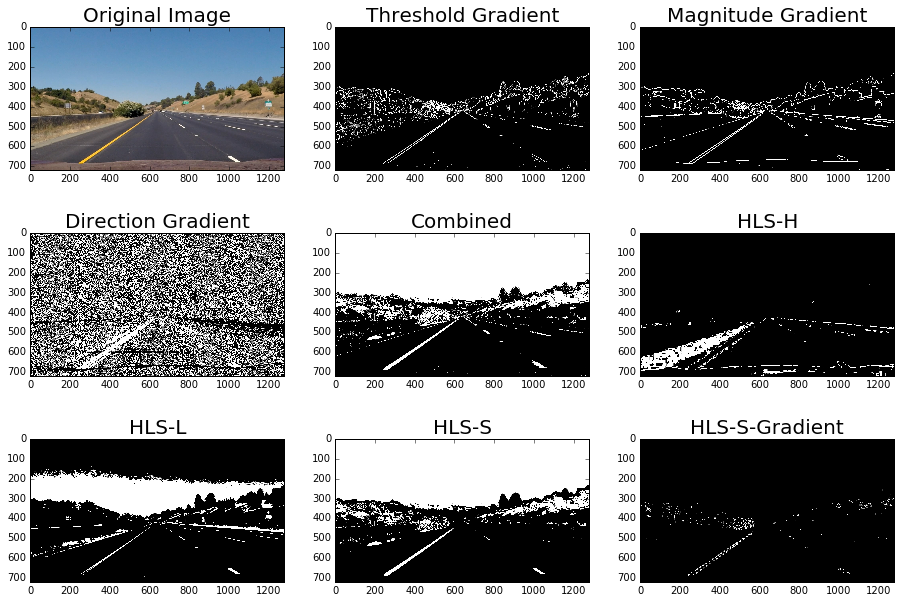

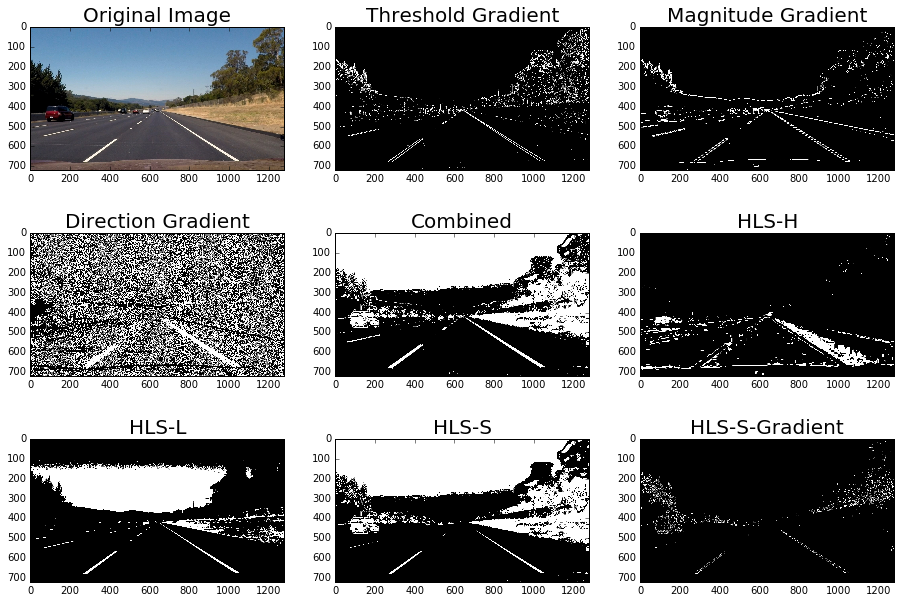

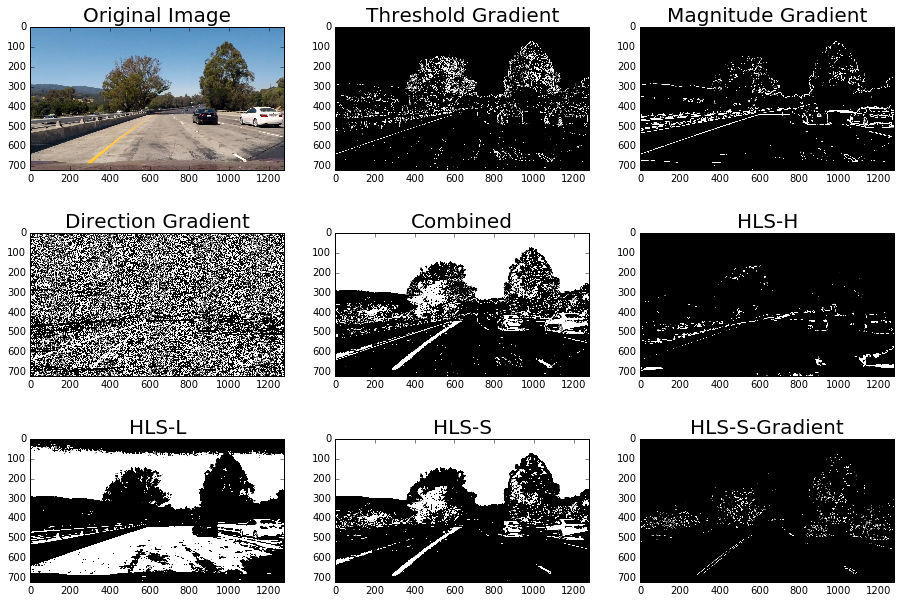

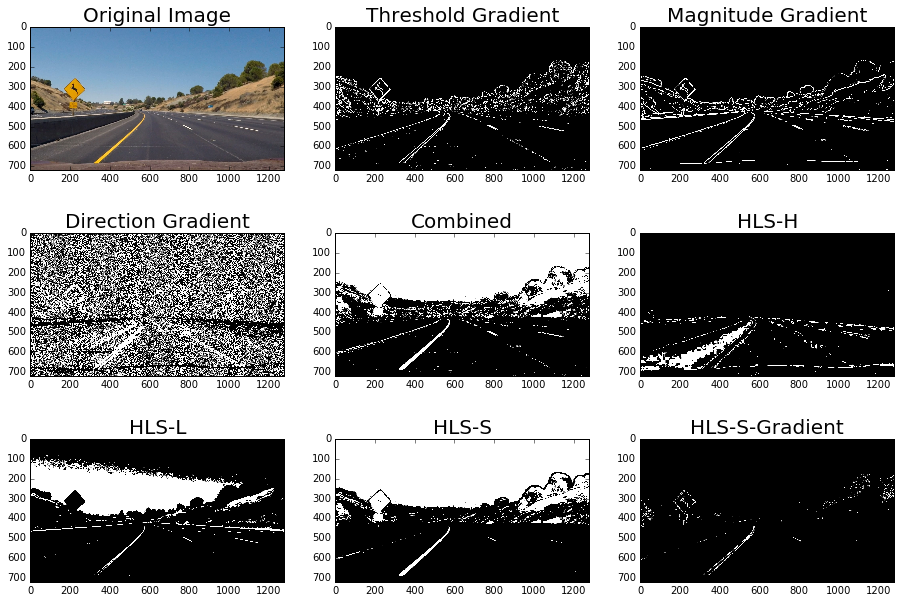

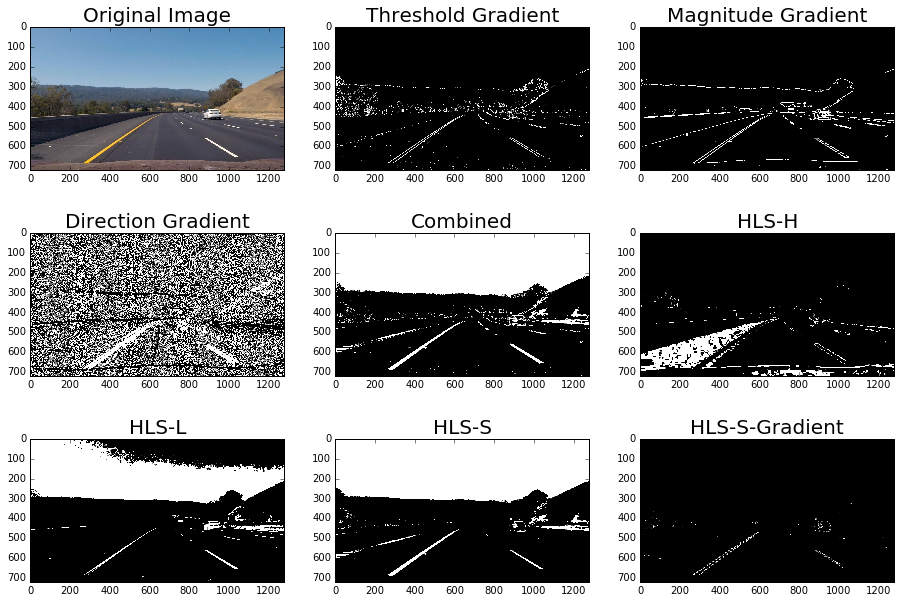

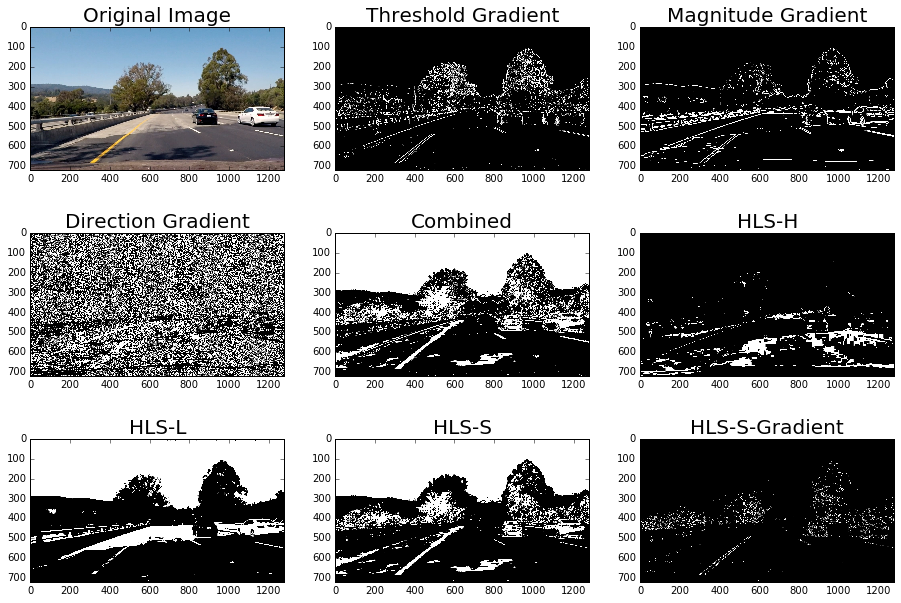

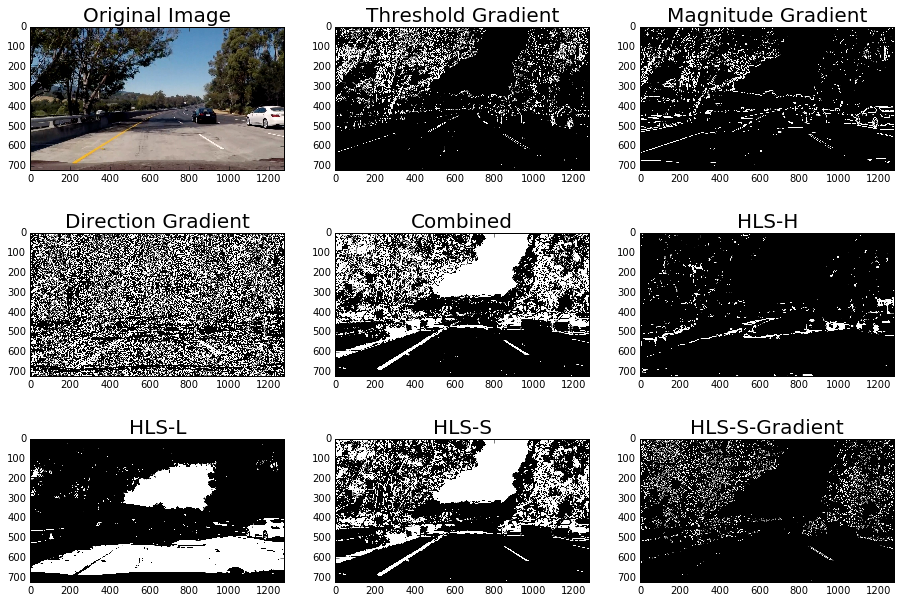

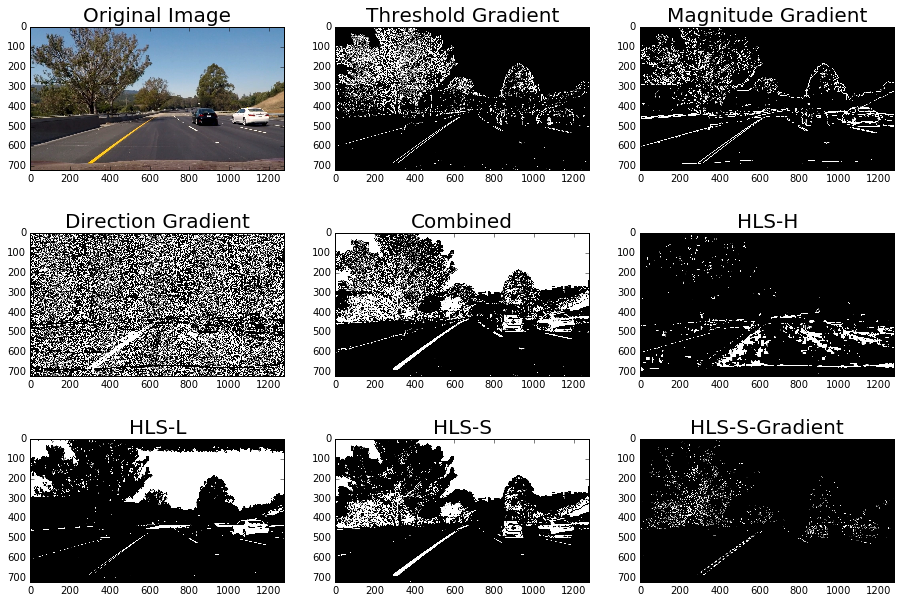

In [9]:
ksize = 3
images = glob.glob('test_images\*.jpg')
for fname in images:
    img = mpimg.imread(fname)
    gradx = abs_sobel_thresh(img[:,:,2], orient='x', thresh_min=20, thresh_max=100)
    mag_binary = mag_thresh(cv2.cvtColor(img, cv2.COLOR_RGB2GRAY), sobel_kernel=ksize, thresh=(30,100))
    dir_binary = dir_threshold(cv2.cvtColor(img, cv2.COLOR_RGB2GRAY), sobel_kernel=15, thresh=(0.43, 0.86))
    hls_h_binary = abs_select(cv2.cvtColor(img, cv2.COLOR_RGB2HLS)[:,:,0], thresh=(150, 255))
    hls_l_binary = abs_select(cv2.cvtColor(img, cv2.COLOR_RGB2HLS)[:,:,1], thresh=(150, 255))
    hls_s_binary = abs_select(cv2.cvtColor(img, cv2.COLOR_RGB2HLS)[:,:,2], thresh=(80, 255))
    hls_s_gradx = abs_sobel_thresh(cv2.cvtColor(img,cv2.COLOR_RGB2HLS)[:,:,2], orient='x', thresh_min=40, thresh_max=100)
    
    combined = np.zeros_like(dir_binary)
    combined[(hls_s_binary == 1) & ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    
    ##----------------

    ksize = 3 # Choose a larger odd number to smooth gradient measurements
    gradx = abs_sobel_thresh(cv2.cvtColor(img, cv2.COLOR_RGB2GRAY), orient='x', thresh_min=20, thresh_max=150)
    grady = abs_sobel_thresh(cv2.cvtColor(img, cv2.COLOR_RGB2GRAY), orient='y', thresh_min=20, thresh_max=255)
    mag_binary = mag_thresh(cv2.cvtColor(img, cv2.COLOR_RGB2GRAY), sobel_kernel=7, thresh=(50,200))
    dir_binary = dir_threshold(cv2.cvtColor(img, cv2.COLOR_RGB2GRAY), sobel_kernel=15, thresh=(0.6, 1.3))
    combined_gradient = np.zeros_like(dir_binary)
    combined_gradient[((gradx == 1) & (grady == 1)) | ((dir_binary == 1) & (mag_binary == 1))] = 1
    ##----------------
    
    
    # color_binary = np.dstack((np.zeros_like(gradx), gradx, hls_s_binary))
    combined = np.zeros_like(gradx)
    combined[(hls_s_binary == 1) | (combined_gradient == 1)] = 1
    
    # Plot the result
    f, (ax0, ax1, ax2) = plt.subplots(3, 3, figsize=(12,9))
    # f.tight_layout()
    ax0[0].imshow(img)
    ax0[0].set_title('Original Image', fontsize=20)
    ax0[1].imshow(gradx, cmap='gray')
    ax0[1].set_title('Threshold Gradient', fontsize=20)
    ax0[2].imshow(mag_binary, cmap='gray')
    ax0[2].set_title('Magnitude Gradient', fontsize=20)
    ax1[0].imshow(dir_binary, cmap='gray')
    ax1[0].set_title('Direction Gradient', fontsize=20)
    ax1[1].imshow(combined, cmap='gray')
    ax1[1].set_title('Combined', fontsize=20)
    ax1[2].imshow(hls_h_binary, cmap='gray')
    ax1[2].set_title('HLS-H', fontsize=20)
    ax2[0].imshow(hls_l_binary, cmap='gray')
    ax2[0].set_title('HLS-L', fontsize=20)
    ax2[1].imshow(hls_s_binary, cmap='gray')
    ax2[1].set_title('HLS-S', fontsize=20)
    ax2[2].imshow(hls_s_gradx, cmap='gray')
    ax2[2].set_title('HLS-S-Gradient', fontsize=20)
    plt.subplots_adjust(left=0, right=1, top=0.9, bottom=0)

In [10]:
# Perspective Transform
fname = 'test_images\straight_lines1.jpg'
img = mpimg.imread(fname)
# plt.imshow(img)
# plt.show()

def region_of_interest(img, vertices):
    return img
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


def compute_perspective_xform():
    img = mpimg.imread(fname)
    img_size = (img.shape[1], img.shape[0])
    # Four source coordinates
    src = np.float32([
            [595,450],
            [687,450],
            [1050,680],
            [275,680]
        ])
    # Four desired coordinates
    dst = np.float32([
            [300,0],
            [980,0],
            [980,720],
            [300,720]
        ])
    # Compute the perspective transform, M
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    # warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    
    # Draw lines
    # cv2.line(img, (600, 447), (679, 447), [255,0,0], 4)
    # cv2.line(img, (679, 447), (1037, 681), [255,0,0], 4)
    # cv2.line(img, (1037, 681), (259, 681), [255,0,0], 4)
    # cv2.line(img, (259, 681), (600, 447), [255,0,0], 4)
    # 
    # cv2.line(warped, (429, 0), (858, 0), [255,0,0], 4)
    # cv2.line(warped, (858, 0), (858, 719), [255,0,0], 4)
    # cv2.line(warped, (858, 719), (429, 719), [255,0,0], 4)
    # cv2.line(warped, (429, 719), (429, 0), [255,0,0], 4)
    # 
    # f, (ax0, ax1) = plt.subplots(1, 2, figsize=(24,9))
    # ax0.imshow(img)
    # ax0.set_title('Original Image', fontsize=20)
    # ax1.imshow(warped)
    # ax1.set_title('Warped Image', fontsize=20)
    # plt.subplots_adjust(left=0, right=1, top=0.9, bottom=0)
    
    return M, Minv

def find_window_centroids(image, window_width, window_height, margin):
    
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(warped[int(3*warped.shape[0]/4):,:int(warped.shape[1]/2)], axis=0)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(warped[int(3*warped.shape[0]/4):,int(warped.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(warped.shape[1]/2)
    
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(warped.shape[0]/window_height)):
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(warped[int(warped.shape[0]-(level+1)*window_height):int(warped.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,warped.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,warped.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
        # Add what we found for that layer
        window_centroids.append((l_center,r_center))

    return window_centroids

def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

def warp(img, M):
    img_size = (img.shape[1], img.shape[0])
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return warped

M, Minv = compute_perspective_xform()


In [11]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None

In [12]:
import copy

left_curverad_prev = 10000
right_curverad_prev = 10000
curverad_prec = 100
left_line_inst = Line()
right_line_inst = Line()

search_type = "full"

def mark_lanes_experiment(img, left_line_inst, right_line_inst):
    global left_curverad_prev
    global right_curverad_prev
    
    undist_img = cv2.undistort(img, mtx, dist, None, mtx)
    
    imshape = undist_img.shape
    vertices = np.array([[(0,imshape[0]),(640, 320), (640, 320), (imshape[1],imshape[0])]], dtype=np.int32)
    masked_img = region_of_interest(undist_img, vertices)
    
    hls_s_binary = abs_select(cv2.cvtColor(undist_img, cv2.COLOR_RGB2HLS)[:,:,2], thresh=(80, 255))
    ksize = 3 # Choose a larger odd number to smooth gradient measurements
    gradx = abs_sobel_thresh(cv2.cvtColor(undist_img, cv2.COLOR_RGB2GRAY), orient='x', thresh_min=20, thresh_max=150)
    grady = abs_sobel_thresh(cv2.cvtColor(undist_img, cv2.COLOR_RGB2GRAY), orient='y', thresh_min=20, thresh_max=255)
    mag_binary = mag_thresh(cv2.cvtColor(undist_img, cv2.COLOR_RGB2GRAY), sobel_kernel=7, thresh=(50,200))
    dir_binary = dir_threshold(cv2.cvtColor(undist_img, cv2.COLOR_RGB2GRAY), sobel_kernel=15, thresh=(0.6, 1.3))
    combined_gradient = np.zeros_like(dir_binary)
    combined_gradient[((gradx == 1) & (grady == 1)) | ((dir_binary == 1) & (mag_binary == 1))] = 1
    combined = np.zeros_like(gradx)
    combined[(hls_s_binary == 1) | (combined_gradient == 1)] = 1
    
    warped = warp(combined, M) # undist_img, M)
    warped_crop = warped[400:680, 0:1280]
    
    # Take a histogram of the image
    histogram = np.sum(warped[warped.shape[0]/2:,:], axis=0)
    #### plt.plot(histogram)
    
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((warped, warped, warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    if left_line_inst.detected == True:
        search_type = "incremental"
        left_lane_inds = ((nonzerox > (left_line_inst.current_fit[0]*(nonzeroy**2) + left_line_inst.current_fit[1]*nonzeroy + left_line_inst.current_fit[2] - margin)) & (nonzerox < (left_line_inst.current_fit[0]*(nonzeroy**2) + left_line_inst.current_fit[1]*nonzeroy + left_line_inst.current_fit[2] + margin))) 
        right_lane_inds = ((nonzerox > (right_line_inst.current_fit[0]*(nonzeroy**2) + right_line_inst.current_fit[1]*nonzeroy + right_line_inst.current_fit[2] - margin)) & (nonzerox < (right_line_inst.current_fit[0]*(nonzeroy**2) + right_line_inst.current_fit[1]*nonzeroy + right_line_inst.current_fit[2] + margin))) 
    else:
        search_type = "full"
        # Step through the windows one by one
        for window in range(nwindows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = warped.shape[0] - (window+1)*window_height
            win_y_high = warped.shape[0] - window*window_height
            win_xleft_low = leftx_current - margin
            win_xleft_high = leftx_current + margin
            win_xright_low = rightx_current - margin
            win_xright_high = rightx_current + margin
            # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
            # Identify the nonzero pixels in x and y within the window
            good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
            good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)
            # If you found > minpix pixels, recenter next window on their mean position
            if len(good_left_inds) > minpix:
                leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            if len(good_right_inds) > minpix:        
                rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
        # Concatenate the arrays of indices
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
        
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Plot the result
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Measure the curvature
    y_eval = np.max(ploty)
    left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    # print(left_curverad, right_curverad)
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
    # print(left_curverad, 'm', right_curverad, 'm')
    
    # Create an image to drw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    #Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    
    # Draw the line onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))
    
    # warp the blank bak to original image space using inverse perspective matrix
    newwarp = cv2.warpPerspective(color_warp, Minv, (undist_img.shape[1], undist_img.shape[0]))
    
    # Combine the result with the original image
    if (abs(left_curverad - left_curverad_prev) > curverad_prec):
        radius_l = "Radius (L) = {:d} (m)".format(int(left_curverad))
    else:
        radius_l = "Radius (L) = {:d} (m)".format(int(left_curverad_prev))
        
    if (abs(right_curverad - right_curverad_prev) > curverad_prec):
        radius_r = "Radius (R) = {:d} (m)".format(int(right_curverad))
    else:
        radius_r = "Radius (R) = {:d} (m)".format(int(right_curverad_prev))
    
    cv2.putText(undist_img, radius_l, (100, 70), cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 255, 255), 2 )
    cv2.putText(undist_img, radius_r, (100, 170), cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 255, 255), 2 )
    cv2.putText(undist_img, search_type, (100, 270), cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 255, 255), 2 )
    filled_img = cv2.addWeighted(undist_img, 1, newwarp, 0.3, 0)
    
    left_curverad_prev = left_curverad
    right_curverad_prev = right_curverad
    
    left_line_inst.detected = False
    left_line_inst.current_fit = left_fit
    
    right_line_inst.detected = False
    right_line_inst.current_fit = right_fit
    
    return filled_img

left_lane_inst = Line()
right_lane_inst = Line()

def mark_lanes(img):
    global left_lane_inst
    global right_lane_inst
    try:
        filled_img = mark_lanes_experiment(img, left_lane_inst, right_lane_inst)
    except:
        return img
    return filled_img

C:\Anaconda3\lib\site-packages\ipykernel-4.6.1-py3.5.egg\ipykernel_launcher.py:36: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


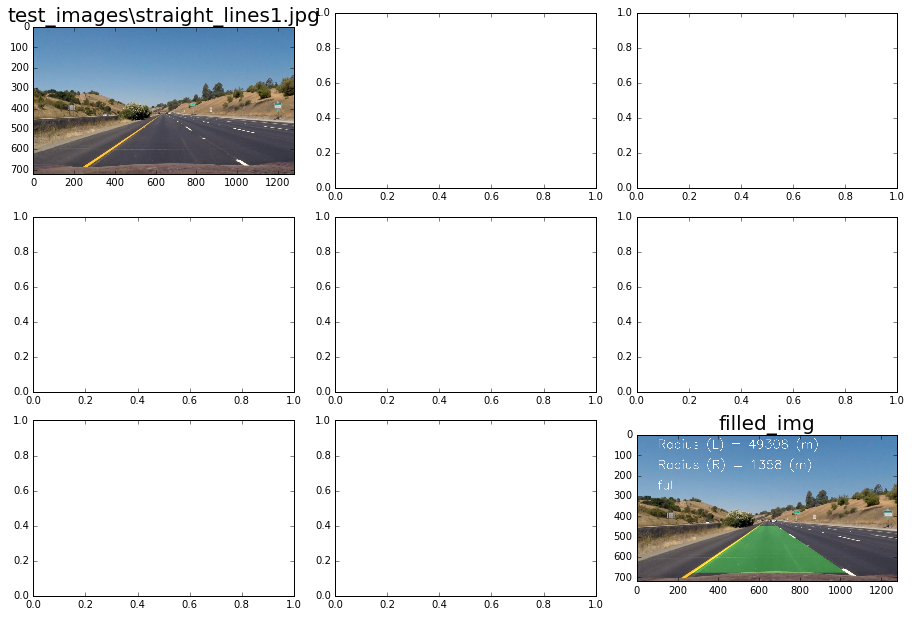

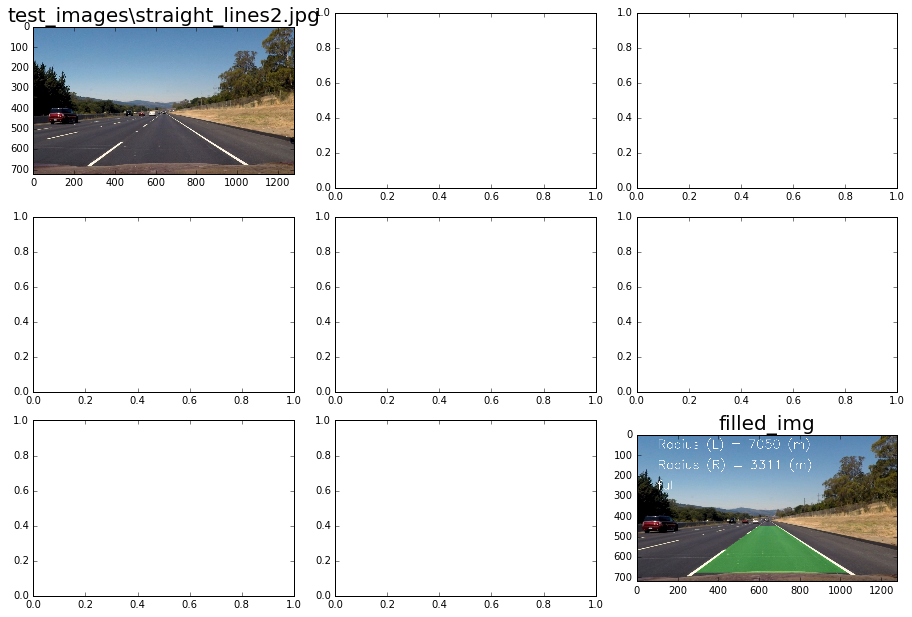

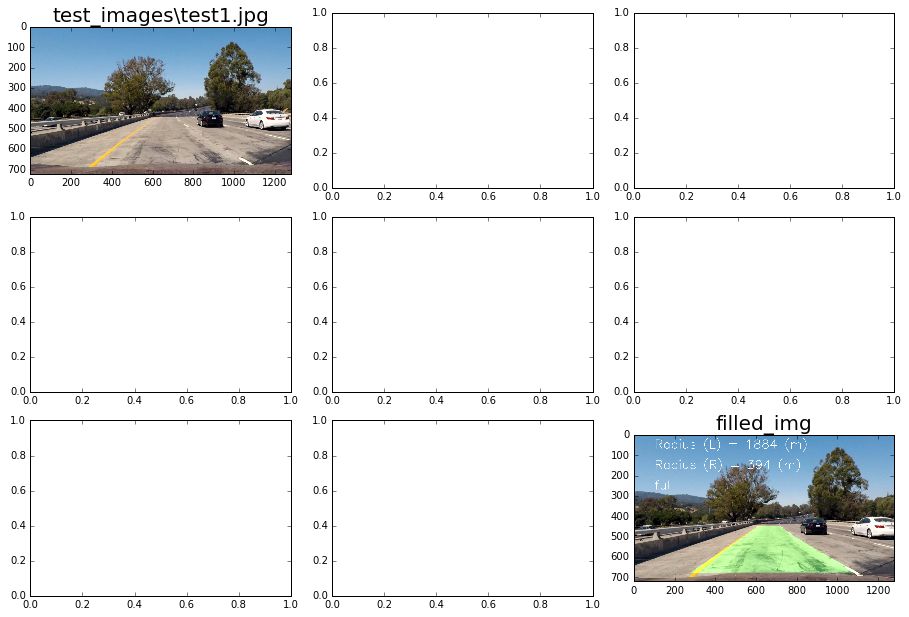

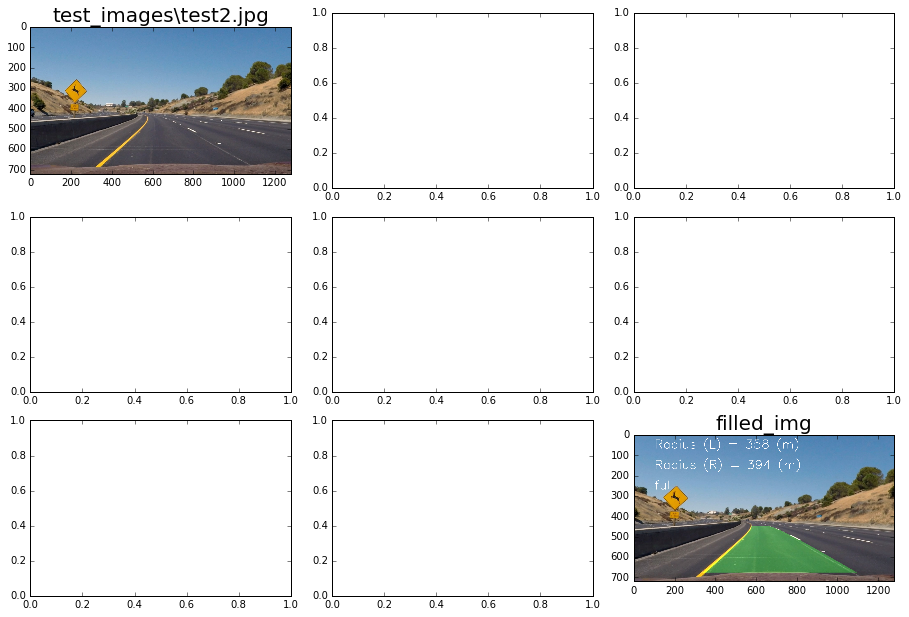

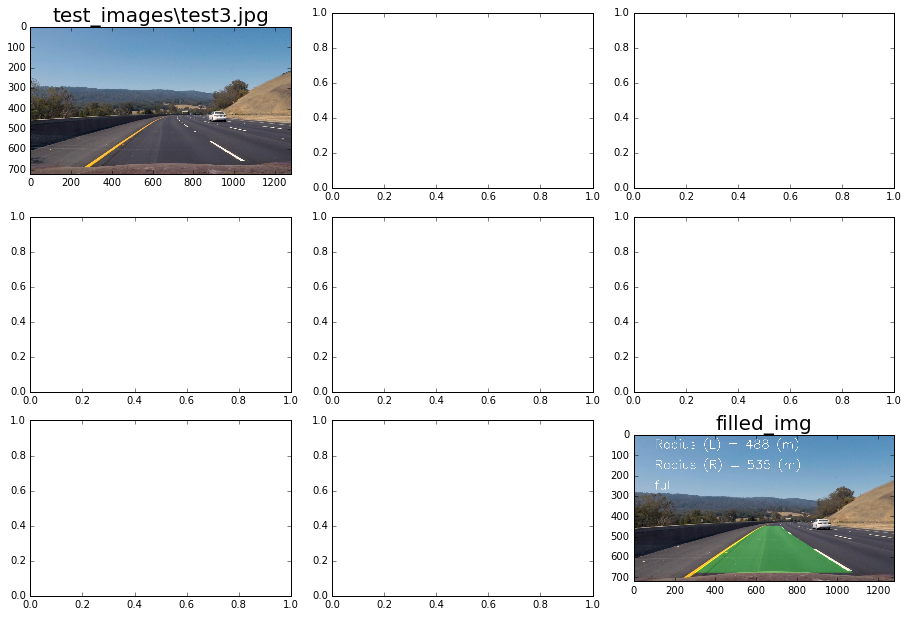

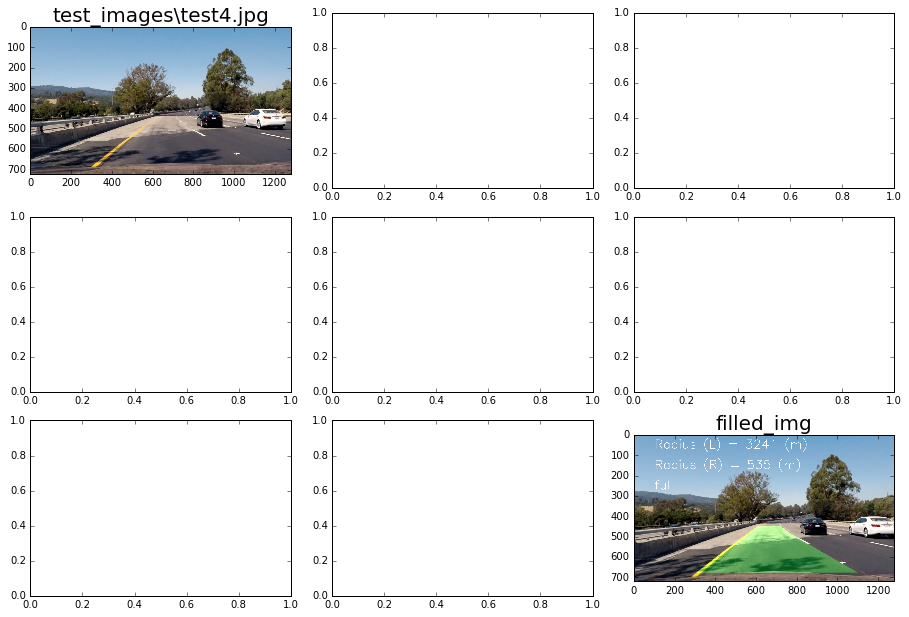

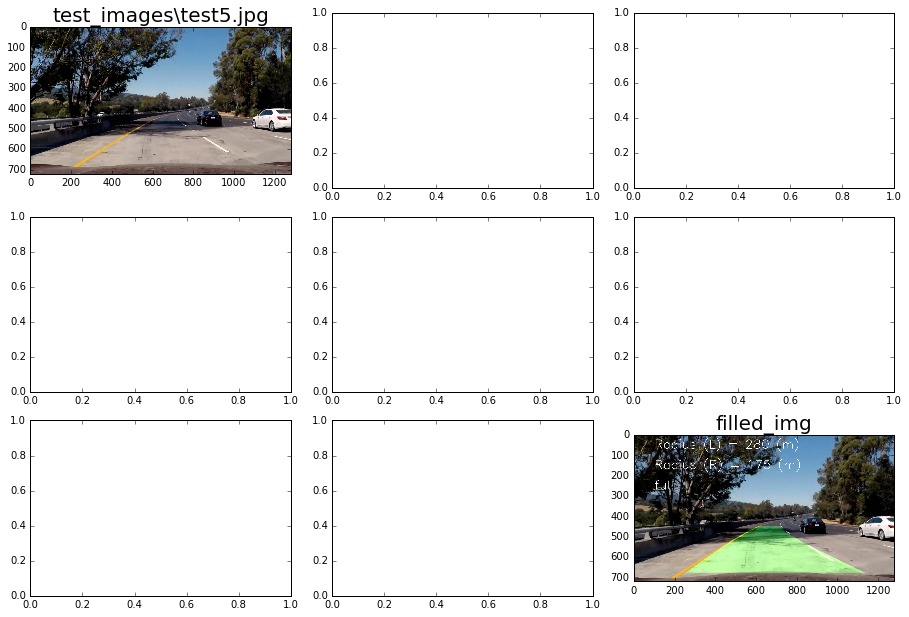

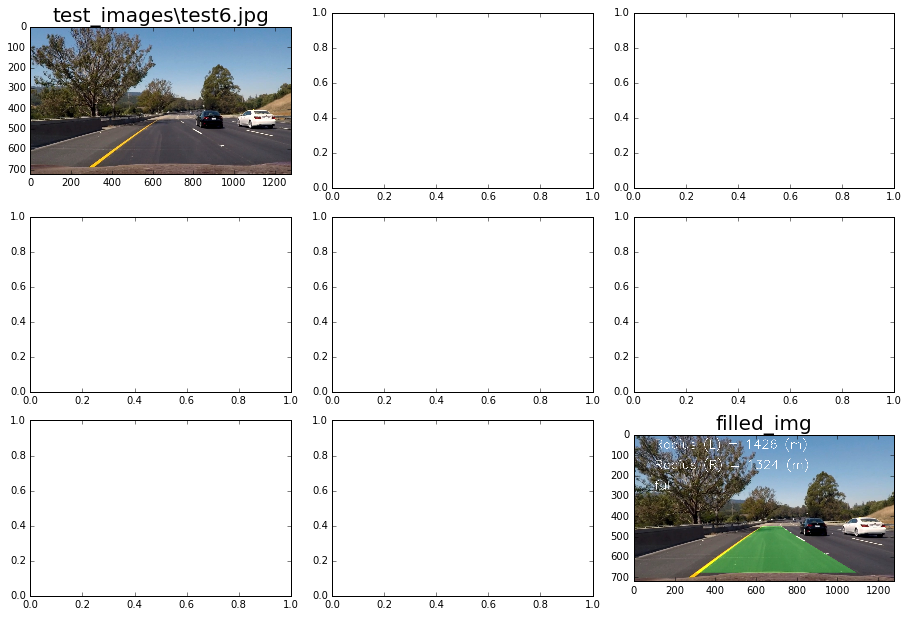

In [13]:
images = glob.glob('test_images\*.jpg')
# images = glob.glob('test_images\*t2.jpg')
for fname in images:
    img = mpimg.imread(fname)
    filled_img = mark_lanes_experiment(img, left_line_inst, right_line_inst)
    
    f, (ax0, ax1, ax2) = plt.subplots(3, 3, figsize=(12,9))
    f.tight_layout()
    ax0[0].imshow(img)
    ax0[0].set_title(fname, fontsize=20)
    ax2[2].imshow(filled_img)
    ax2[2].set_title('filled_img', fontsize=20)
    plt.subplots_adjust(left=0, right=1, top=0.9, bottom=0)


In [14]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML
import inspect

left_line_inst.detected = False
right_line_inst.detected = False

proj_out = 'proj_out.mp4'
clip = VideoFileClip("project_video.mp4")
proj_clip = clip.fl_image(mark_lanes)
%time proj_clip.write_videofile(proj_out, audio=False)

[MoviePy] >>>> Building video proj_out.mp4
[MoviePy] Writing video proj_out.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [08:42<00:00,  1.65it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: proj_out.mp4 

Wall time: 8min 46s


In [15]:
HTML("""
<video width ="940" height="540" controls>
  <source src="{0}">
</video>
""".format(proj_out))